## 0. 시도해 볼 수 있는 방법들
* 계층 군집화

* **KMeans**

* DBSCAN

* Self-Organizing Map

* https://scikit-learn.org/stable/auto_examples/cluster/plot_cluster_comparison.html#sphx-glr-auto-examples-cluster-plot-cluster-comparison-py

* 기복의 편차를 정량화도 중요
* 난전인지 아닌지?

## 1. 사용 library import

In [310]:
import os
from time import sleep, time
from collections import deque
from itertools import combinations
from pprint import pprint
import math

import numpy as np
import pandas as pd

from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from umap import UMAP

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import squarify

from pandas_profiling import ProfileReport

plt.style.use('seaborn-whitegrid')
matplotlib.rcParams['font.family']='Malgun Gothic'
matplotlib.rcParams['axes.unicode_minus'] = False

import warnings
warnings.filterwarnings('ignore')

## 2. 생성된 Data Frame 불러오기

In [211]:
df = pd.read_csv('./data/2020_torunaments.csv')
df.head()

,dbnos,assists,boosts,damage_dealt,death_type,headshot_kills,heals,kill_place,kill_streaks,kills,...,walk_distance,weapons_acquired,win_place,match_mapName,match_duration,match_createdAt,roster_rank,roster_won,tournament_id,tournament_createdAt
0,1,0,2,178.78679,byplayer,0,7,20,1,1,...,706.84840,7,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
1,0,0,1,0.00000,byplayer,0,1,33,0,0,...,630.31635,4,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
2,1,0,1,100.00000,byplayer,0,3,34,0,0,...,1328.34330,3,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
3,1,0,0,207.98430,byplayer,0,1,21,1,1,...,1109.39770,4,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
4,1,0,3,189.19508,byplayer,1,6,25,1,1,...,1024.16360,3,8,Miramar,1742,2020-12-19T07:39:25Z,8,False,as-pwi20,2020-12-19T07:04:54Z


## 3. DataFrame 전처리
1. 이름 전처리
    * name 컬럼 소문자로 변경
    * 팀명 컬럼 생성
    * 선수 name 컬럼 변경
    * 구분자 '-' 사용한 인원 처리
    * name==''이면 삭제
2. 날짜 데이터 타입 변경

3. logout 데이터 삭제
    * 전체 로그아웃의 경우가 많음
4. relative_time_survived 컬럼 생성
    * 경기마다 총 경기시간이 다르므로 상대 시간 컬럼을 생성한다.
5. total_distance 컬럼 생성
    * total_distance =  walk_distance + ride_distance + swim_distance 
6. match 별 참가팀 10개 이하 삭제
    * 이벤트 경기이거나 개인전일 확률이 큼
7. 토너먼트에서 참가한 경기수가 5개 미만 or 팀원의 수가 3명 미만 삭제
    * 옵저버, test, 예선탈락일 확률이 큼
8. win_place 컬럼 삭제 
    * roster_rank 컬럼과 win_place 컬럼의 차이가 있고 win_place 컬럼에 문제를 확인
9. relative_roster_rank 생성
    * 매 경기 참가 팀의 수가 다른 문제를 해결
10. 생존 시간 당 데미지 컬럼 생성
    * relative_damage_dealt = damage_dealt / time_survived

11. 시간당 활동량
    * distance =  total_distance / time_survived
    
12. tournament_id = eu-testq 제거

-----------------------------
* **컬럼** **삭제**
    - win_place
* **컬럼** **생성**
    - team_name
    - relative_kills
    - relative_time_survived
    - total_distance
    - relative_rank

In [212]:
def preprocess(df):
    ### 1. 이름 전처리
    
    # 1-1. 이름 소문자로 변경
    df['name'] = df.name.str.lower()
    
    # 1-2. 팀명 컬럼 생성
    tmp =  df['name'].str.split('_', expand=True) # 분할 dataframe
    df['team_name'] = tmp[0]
    
    # 1-3. 선수 name 컬럼 변경
    tmp.fillna('', inplace=True)
    df['name'] = tmp.iloc[:, 1:].sum(axis=1)
    
    # 1-4. '_'가 아닌 '-'로 구분한 아이디 처리
    tmp = df.loc[df['name']=='', 'team_name'].str.split('-',  expand=True)
    tmp.fillna('', inplace=True)
    df.loc[df['name']=='', 'team_name'] =  tmp[0]
    df.loc[df['name']=='', 'name'] = tmp.iloc[:, 1:].sum(axis=1)
    
    # 1-5. 'name'이 없다면 삭제
    df = df.query("name!=''")
    
    ### 2. 날짜 데이터 타입 변경
    for col in set(df.columns) - set(['match_mapName','match_createdAt', 'death_type', 'name', 'team_name', 'player_id', 'roster_won', 'tournament_id', 'tournament_createdAt']):
        df[col] = df[col].astype(np.float32)
        df['match_createdAt'] = pd.to_datetime(df['match_createdAt'])
        df['tournament_createdAt'] = pd.to_datetime(df['tournament_createdAt'])
    
    ### 3. logout 데이터 삭제
    df = df.query("death_type!='logout'")
    
    #### 4. relative_time_survived 컬럼 생성
    df['relative_time_survived'] = df.time_survived / df.match_duration
    df.loc[df['relative_time_survived']>1, 'relative_time_survived'] = 1
    df.loc[df['relative_time_survived'] == np.inf, 'relative_time_survived'] = 0
    
    #### 5. total_distance 생성
    df['total_distance'] = df[['ride_distance', 'swim_distance', 'walk_distance']].sum(axis=1)
    
    #### 6. match 별 참가팀 10개 이하 삭제
    gp_by_match = df.groupby(['match_createdAt'])
    for date, tmp in gp_by_match:
        if len(tmp['roster_rank'].unique()) <= 10:
            df.drop(index = tmp.index.values, inplace=True)    
    
    #### 7. 토너먼트에서 참가한 경기수가 5개 미만 or 팀원의 수가 3명 미만 삭제
    gp_by_tour_team = df.groupby(['tournament_id', 'team_name', 'name'])[['match_createdAt']].count()
    tour_ids = df['tournament_id'].unique()
    tour_dict = {tour_id:set()  for tour_id in tour_ids}
    for a,b ,c in gp_by_tour_team.index:
        tour_dict[a].add(b)
    for tour_id in tour_ids:
        for team_name in tour_dict[tour_id]:
            if gp_by_tour_team.loc[(tour_id, team_name), :].max()[0] <5 or gp_by_tour_team.loc[(tour_id, team_name), :].shape[0]<=3:
                cond = (df.tournament_id==tour_id) & (df.team_name==team_name)
                df = df.loc[~cond]
        
    #### 8. win_place 컬럼 삭제
    df.drop(columns=['win_place'], inplace=True)
    
    #### 9. relative_rank 컬럼 생성
    gp_by_match = df.groupby(['match_createdAt'])
    df['relative_rank'] = np.nan
    for date, tmp in gp_by_match:
        l = len(tmp['roster_rank'].unique())
        df.loc[tmp.index.values,'relative_rank'] = df.loc[tmp.index.values,'roster_rank'] / l
    
    ### 10. relative_damage_dealt
    df['relative_damage_dealt'] = df.damage_dealt / df.time_survived

    ### 11. relative_kills
    df['relative_kills'] = df.damage_dealt / df.time_survived
    
    ### 12. tournament_id = eu-testq 제거  
    df = df.query('tournament_id!="eu-testq"')
    return df
df = preprocess(df)

In [216]:
df.head()

,dbnos,assists,boosts,damage_dealt,death_type,headshot_kills,heals,kill_place,kill_streaks,kills,...,roster_rank,roster_won,tournament_id,tournament_createdAt,team_name,relative_time_survived,total_distance,relative_rank,relative_damage_dealt,relative_kills
0,1.0,0.0,2.0,178.786789,byplayer,0.0,7.0,20.0,1.0,1.0,...,4.0,False,as-pwi20,2020-12-19 07:04:54+00:00,dgw,0.960845,10779.292969,0.25,0.106815,0.106815
1,0.0,0.0,1.0,0.000000,byplayer,0.0,1.0,33.0,0.0,0.0,...,4.0,False,as-pwi20,2020-12-19 07:04:54+00:00,dgw,0.632143,10652.504883,0.25,0.000000,0.000000
2,1.0,0.0,1.0,100.000000,byplayer,0.0,3.0,34.0,0.0,0.0,...,4.0,False,as-pwi20,2020-12-19 07:04:54+00:00,dgw,0.625406,10892.470703,0.25,0.091789,0.091789
3,1.0,0.0,0.0,207.984299,byplayer,0.0,1.0,21.0,1.0,1.0,...,4.0,False,as-pwi20,2020-12-19 07:04:54+00:00,dgw,0.634925,10456.398438,0.25,0.188044,0.188044
4,1.0,0.0,3.0,189.195084,byplayer,1.0,6.0,25.0,1.0,1.0,...,8.0,False,as-pwi20,2020-12-19 07:04:54+00:00,cgx,0.834440,11342.478516,0.50,0.130157,0.130157


##  4. 참여 컬럼(컬럼 추가 제거)

- categorical 변수 삭제
    - 선수들의 평균값으로 평가해야하기 때문에 범주형변수는 사용 불가
- kill_place
    - 오류가 있을 수 있고, kills가 대변한다.
- time_survived, match_duration
    - relative_time_survived로 대체

In [217]:
num_columns = set([c for c, d in zip(df.columns, df.dtypes)  if d!='O'])
num_columns = num_columns - set(['kill_place', 'kill_streaks', 'tournament_createdAt', 'match_createdAt', 'time_survived', 'match_duration', 'roster_won', 'road_kills', 'swim_distance'])
num_columns.add('name')
num_columns

{'assists',
 'boosts',
 'damage_dealt',
 'dbnos',
 'headshot_kills',
 'heals',
 'kills',
 'longest_kill',
 'name',
 'relative_damage_dealt',
 'relative_kills',
 'relative_rank',
 'relative_time_survived',
 'revives',
 'ride_distance',
 'roster_rank',
 'team_kills',
 'total_distance',
 'vehicle_destroys',
 'walk_distance',
 'weapons_acquired'}

In [218]:
df_num = df[num_columns]
df_num

,headshot_kills,ride_distance,vehicle_destroys,walk_distance,assists,weapons_acquired,name,relative_kills,relative_damage_dealt,roster_rank,...,total_distance,damage_dealt,kills,boosts,relative_time_survived,revives,longest_kill,heals,relative_rank,dbnos
0,0.0,10072.444336,0.0,706.848389,0.0,7.0,ssees,0.106815,0.106815,4.0,...,10779.292969,178.786789,1.0,2.0,0.960845,0.0,4.594472,7.0,0.250000,1.0
1,0.0,10022.188477,0.0,630.316345,0.0,4.0,melofo,0.000000,0.000000,4.0,...,10652.504883,0.000000,0.0,1.0,0.632143,0.0,0.000000,1.0,0.250000,0.0
2,0.0,9564.126953,0.0,1328.343262,0.0,3.0,machao,0.091789,0.091789,4.0,...,10892.470703,100.000000,0.0,1.0,0.625406,0.0,0.000000,3.0,0.250000,1.0
3,0.0,9347.000977,0.0,1109.397705,0.0,4.0,gokuri,0.188044,0.188044,4.0,...,10456.398438,207.984299,1.0,0.0,0.634925,0.0,104.266151,1.0,0.250000,1.0
4,1.0,10318.315430,0.0,1024.163574,0.0,3.0,eguto,0.130157,0.130157,8.0,...,11342.478516,189.195084,1.0,3.0,0.834440,0.0,227.473068,6.0,0.500000,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135155,0.0,12616.843750,0.0,1137.948242,0.0,5.0,resunzmall,0.012034,0.012034,7.0,...,13754.791992,18.449999,0.0,3.0,0.843335,0.0,0.000000,1.0,0.388889,0.0
135156,0.0,2386.679688,0.0,2369.788574,1.0,7.0,psychopathy-,0.021126,0.021126,13.0,...,4756.468262,27.376270,0.0,4.0,0.712781,0.0,0.000000,0.0,0.722222,0.0
135157,0.0,2709.862549,0.0,1164.915039,0.0,6.0,helloweend,0.000000,0.000000,13.0,...,3874.777588,0.000000,0.0,2.0,0.616426,0.0,0.000000,0.0,0.722222,0.0
135158,0.0,2375.161865,0.0,1480.251465,0.0,5.0,kimhayur,0.061983,0.061983,13.0,...,3855.413330,78.000000,1.0,8.0,0.692196,0.0,23.056494,1.0,0.722222,1.0


In [219]:
df_num.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 132020 entries, 0 to 135159
Data columns (total 21 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   headshot_kills          132020 non-null  float32
 1   ride_distance           132020 non-null  float32
 2   vehicle_destroys        132020 non-null  float32
 3   walk_distance           132020 non-null  float32
 4   assists                 132020 non-null  float32
 5   weapons_acquired        132020 non-null  float32
 6   name                    132020 non-null  object 
 7   relative_kills          132020 non-null  float32
 8   relative_damage_dealt   132020 non-null  float32
 9   roster_rank             132020 non-null  float32
 10  team_kills              132020 non-null  float32
 11  total_distance          132020 non-null  float32
 12  damage_dealt            132020 non-null  float32
 13  kills                   132020 non-null  float32
 14  boosts              

## 5. 선수별 grouping (평균값)

In [299]:
df_train = df_num.groupby('name').mean()
df_train

,headshot_kills,ride_distance,vehicle_destroys,walk_distance,assists,weapons_acquired,relative_kills,relative_damage_dealt,roster_rank,team_kills,total_distance,damage_dealt,kills,boosts,relative_time_survived,revives,longest_kill,heals,relative_rank,dbnos
name,,,,,,,,,,,,,,,,,,,,
0205,0.000000,0.000000,0.000000,789.609985,0.000000,3.666667,0.070265,0.070265,12.333333,0.000000,789.609985,26.083160,0.000000,0.000000,0.314045,0.000000,0.000000,0.333333,0.861905,0.000000
0312,0.000000,4419.015137,0.000000,1374.402466,0.200000,3.800000,0.144775,0.144775,11.100000,0.000000,5816.028320,135.846497,0.600000,2.400000,0.551786,0.000000,39.144623,3.200000,0.708750,0.600000
0510,0.250000,2341.348145,0.055556,1652.846680,0.444444,3.805556,0.178479,0.178479,8.666667,0.000000,4013.462158,196.447601,1.138889,3.416667,0.670122,0.194444,42.543083,2.194444,0.541667,1.222222
067tezo,0.166667,3796.841797,0.033333,1254.332886,0.622222,4.522222,0.161050,0.161050,9.322222,0.011111,5051.373047,188.879349,0.833333,2.544445,0.648235,0.188889,57.807545,1.733333,0.582639,1.100000
067xxx,0.300000,3912.184814,0.066667,1491.870605,1.066667,4.400000,0.186166,0.186166,8.200000,0.000000,5404.589844,247.052551,1.133333,2.366667,0.701544,0.133333,77.798149,1.866667,0.512500,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
zrayven,0.166667,5511.406250,0.000000,1022.851929,0.250000,4.083333,0.133487,0.133487,9.083333,0.083333,6534.258301,177.059616,1.833333,2.416667,0.604638,0.416667,35.380802,3.333333,0.567708,1.166667
zubila,0.071429,3564.002930,0.000000,1242.880005,0.428571,4.142857,0.153598,0.153598,9.000000,0.000000,4806.882812,191.164215,0.357143,2.357143,0.607775,0.000000,50.301586,2.714286,0.562500,0.785714
zuxy,0.166667,3044.966553,0.000000,1919.153320,0.333333,4.666667,0.119338,0.119338,8.000000,0.000000,4965.818848,142.238647,0.833333,1.833333,0.725937,0.166667,142.037979,2.000000,0.500000,0.500000


## 6. K-means

### 6.1. 20개 컬럼 사용

- #### scaling

In [279]:
scaler = StandardScaler()
df_train_scaled = scaler.fit_transform(df_train)

- #### clustering 개수 결정

##### SSE

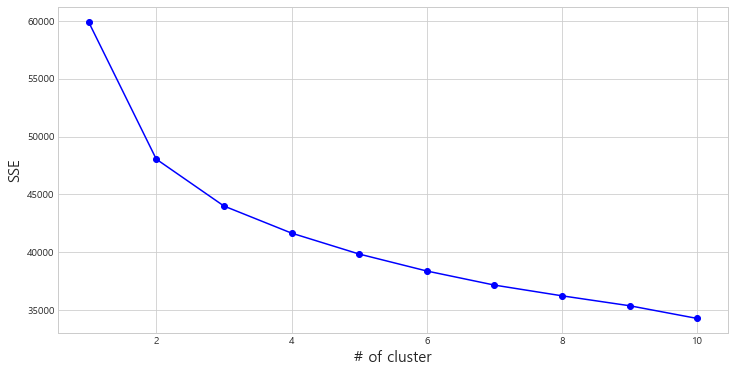

In [228]:
sse = []
for n in range(1,11):
    model = KMeans(n_clusters=n, random_state=101)
    km = model.fit(df_train_scaled)
    sse.append(km.inertia_)

plt.figure(figsize=(12, 6))
plt.plot(range(1, 11), sse, 'bo-')
plt.xlabel('# of cluster', fontsize=15)
plt.ylabel('SSE', fontsize=15)
plt.show()

##### 실루엣

In [248]:
### 여러개의 클러스터링 갯수를 List로 입력 받아 각각의 실루엣 계수를 면적으로 시각화한 함수 작성
def visualize_silhouette(clustering, X_features, cluster_lists): 
    
    # 입력값으로 클러스터링 갯수들을 리스트로 받아서, 각 갯수별로 클러스터링을 적용하고 실루엣 개수를 구함
    n_cols = len(cluster_lists)
    
    # plt.subplots()으로 리스트에 기재된 클러스터링 수만큼의 sub figures를 가지는 axs 생성 
    fig, axs = plt.subplots(figsize=(4*n_cols, 4), nrows=1, ncols=n_cols)
    
    # 리스트에 기재된 클러스터링 갯수들을 차례로 iteration 수행하면서 실루엣 개수 시각화
    for ind, n_cluster in enumerate(cluster_lists):
        
        if clustering[0] == 'hierarchical':
            model = AgglomerativeClustering(n_clusters=n_cluster, linkage=clustering[1])
        elif clustering[0] == 'kmeans':
            model = KMeans(n_clusters=n_cluster)
        # KMeans 클러스터링 수행하고, 실루엣 스코어와 개별 데이터의 실루엣 값 계산. 
        cluster_labels = model.fit_predict(X_features)
        
        #if clustering[0] == 'dbscan':
        #    n_cluster = len(set(cluster_labels))-1
        
        sil_avg = silhouette_score(X_features, cluster_labels)
        sil_values = silhouette_samples(X_features, cluster_labels)
        
        y_lower = 10
        axs[ind].set_title('Number of Cluster : '+ str(n_cluster)+'\n' \
                          'Silhouette Score :' + str(round(sil_avg,3)) )
        axs[ind].set_xlabel("The silhouette coefficient values")
        axs[ind].set_ylabel("Cluster label")
        axs[ind].set_xlim([-0.1, 1])
        axs[ind].set_ylim([-1, len(X_features) + (n_cluster + 1) * 10])
        axs[ind].set_yticks([])  # Clear the yaxis labels / ticks
        axs[ind].set_xticks([0, 0.2, 0.4, 0.6, 0.8, 1])
        
        # 클러스터링 갯수별로 fill_betweenx( )형태의 막대 그래프 표현. 
        for i in range(n_cluster):
            ith_cluster_sil_values = sil_values[cluster_labels==i]
            ith_cluster_sil_values.sort()
            
            size_cluster_i = ith_cluster_sil_values.shape[0]
            y_upper = y_lower + size_cluster_i
            
            color = cm.nipy_spectral(float(i) / n_cluster)
            axs[ind].fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_sil_values, \
                                facecolor=color, edgecolor=color, alpha=0.7)
            axs[ind].text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
            y_lower = y_upper + 10
            
        axs[ind].axvline(x=sil_avg, color="red", linestyle="--")

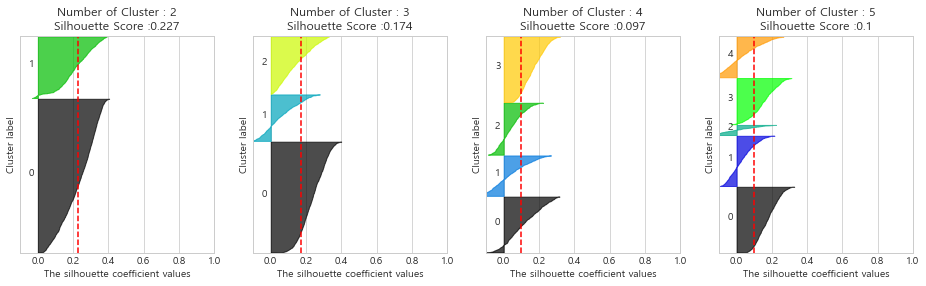

In [250]:
visualize_silhouette(['kmeans'], df_res, [2, 3, 4, 5])

In [243]:
params = {'n_clusters':[2, 3, 4, 5, 6, 7]}

silhouette_dict = {}
for n_cluster in params['n_clusters']:
    model = KMeans(n_clusters=n_cluster, random_state=101)
    res = model.fit_predict(df_train_scaled)
    score = silhouette_score(df_train_scaled, res)
    silhouette_dict[n_cluster] = score

pd.Series(silhouette_list).sort_values(ascending=False)[:10]

# 전반적으로 scaling을 적용한 후에 silhouette score가 낮아졌다.
# 아무래도 scaling하기 전의 척도가 군집화를 수행함에 있어 적절했던 것으로 예상된다.
# (데이터마다 scaling이 좋을수도, 나쁠수도 있다.)

0    0.180526
1    0.134981
2    0.108540
3    0.089303
4    0.088929
5    0.088399
dtype: float64

- #### n_cluster=3

In [280]:
kmeans = KMeans(n_clusters=3, random_state=101)
kmeans.fit(df_train_scaled)
res = kmeans.predict(df_train_scaled)

df_res = pd.DataFrame(df_train_scaled, columns=df_train.columns)
df_res['label'] = res

- #### 차원축소로 시각화

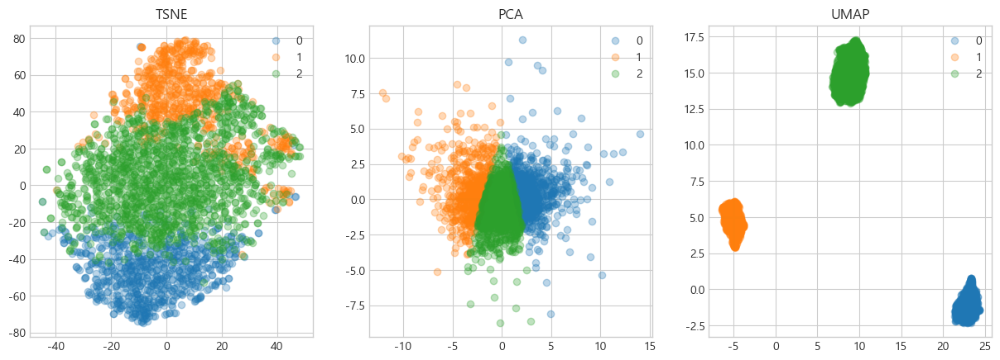

In [281]:
tsne = TSNE(random_state=0)
data_sample_dr = tsne.fit_transform(df_train_scaled, res)

fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi=100)

for i in range(3):
    ax[0].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[0].legend()
ax[0].set_title('TSNE')

pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_train_scaled, res)
for i in range(3):
    ax[1].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[1].legend()
ax[1].set_title('PCA')

umap = UMAP(random_state=0)
data_sample_dr = umap.fit_transform(df_train_scaled, res)

for i in range(3):
    ax[2].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[2].legend()
ax[2].set_title('UMAP')

plt.show()

- #### 컬럼별 군집화 결과 시각화

In [227]:
combs = combinations(df_res.iloc[:,:-1].columns, 2)

fig, ax = plt.subplots(51, 3, figsize=(12, 204), dpi=200)
for (col1, col2), axis in zip(combs, ax.flatten()):
    sns.scatterplot(data=df_res, x=col1, y=col2, hue='label', ax=axis)
    axis.set_xlabel(col1)
    axis.set_ylabel(col2)
fig.tight_layout()
plt.show()

### 6.2. 13개 컬럼 사용
* 삭제한 컬럼
    * revives
    * team_kills
    * heals
    * vehicle_destroys
    * weapons_acquired
    * roster_rank
    * ride_distance

In [301]:
df_train.drop(columns=['revives', 'team_kills', 'heals', 'vehicle_destroys', 'weapons_acquired', 'ride_distance', 'roster_rank'], inplace=True)
df_train.head()

,headshot_kills,walk_distance,assists,relative_kills,relative_damage_dealt,total_distance,damage_dealt,kills,boosts,relative_time_survived,longest_kill,relative_rank,dbnos
name,,,,,,,,,,,,,
0205,0.000000,789.609985,0.000000,0.070265,0.070265,789.609985,26.083160,0.000000,0.000000,0.314045,0.000000,0.861905,0.000000
0312,0.000000,1374.402466,0.200000,0.144775,0.144775,5816.028320,135.846497,0.600000,2.400000,0.551786,39.144623,0.708750,0.600000
0510,0.250000,1652.846680,0.444444,0.178479,0.178479,4013.462158,196.447601,1.138889,3.416667,0.670122,42.543083,0.541667,1.222222
067tezo,0.166667,1254.332886,0.622222,0.161050,0.161050,5051.373047,188.879349,0.833333,2.544445,0.648235,57.807545,0.582639,1.100000
067xxx,0.300000,1491.870605,1.066667,0.186166,0.186166,5404.589844,247.052551,1.133333,2.366667,0.701544,77.798149,0.512500,1.000000


- #### scaling

In [302]:
scaler = StandardScaler()
df_train_scaled = scaler.fit_transform(df_train)

* #### clustering 개수 결정

##### SSE

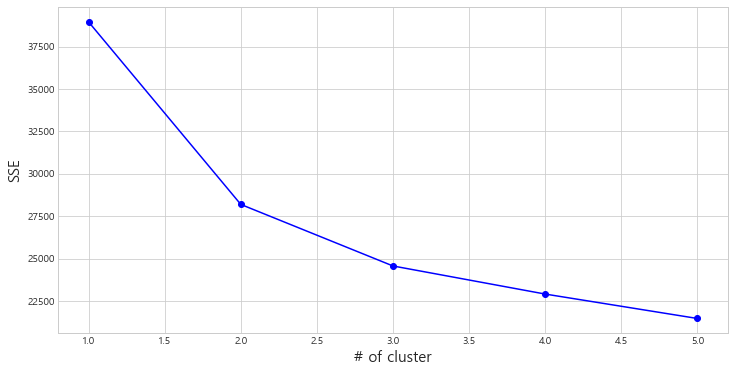

In [303]:
sse = []
for n in range(1,6):
    model = KMeans(n_clusters=n, random_state=101)
    km = model.fit(df_train_scaled)
    sse.append(km.inertia_)

plt.figure(figsize=(12, 6))
plt.plot(range(1, 6), sse, 'bo-')
plt.xlabel('# of cluster', fontsize=15)
plt.ylabel('SSE', fontsize=15)
plt.show()

In [304]:
kmeans = KMeans(n_clusters=3, random_state=101)
kmeans.fit(df_train_scaled)
res = kmeans.predict(df_train_scaled)

df_res = pd.DataFrame(df_train_scaled, columns=df_train.columns)
df_res['label'] = res

- #### 차원축소로 시각화

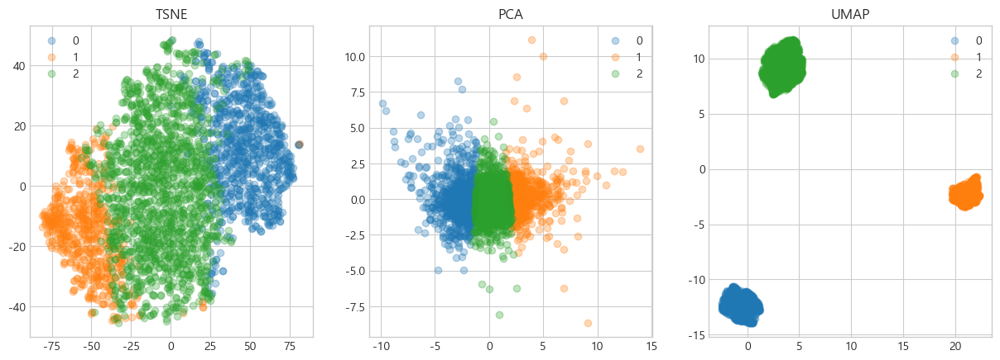

In [306]:
tsne = TSNE(random_state=0)
data_sample_dr = tsne.fit_transform(df_train_scaled, res)

fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi=100)

for i in range(3):
    ax[0].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[0].legend()
ax[0].set_title('TSNE')

pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_train_scaled, res)
for i in range(3):
    ax[1].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[1].legend()
ax[1].set_title('PCA')

umap = UMAP(random_state=0)
data_sample_dr = umap.fit_transform(df_train_scaled, res)

for i in range(3):
    ax[2].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[2].legend()
ax[2].set_title('UMAP')

plt.show()

In [ ]:
13 * 13 = 130 + 39

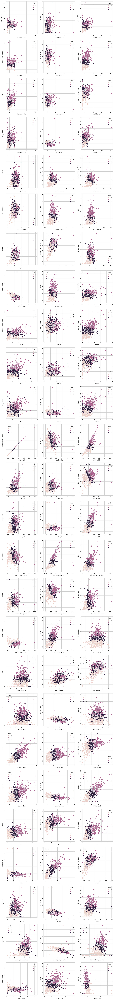

In [320]:
combs = combinations(df_res.iloc[:,:-1].columns, 2)

fig, ax = plt.subplots(26, 3, figsize=(12, 104), dpi=200)
for (col1, col2), axis in zip(combs, ax.flatten()):
    sns.scatterplot(data=df_res, x=col1, y=col2, hue='label', ax=axis)
    axis.set_xlabel(col1)
    axis.set_ylabel(col2)
fig.tight_layout()
plt.show()